https://stackoverflow.com/questions/753190/programmatically-generate-video-or-animated-gif-in-python

In [1]:
import imageio
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from scipy.stats import beta

from IPython.display import Image

In [2]:
from pathlib import Path
import os
gifspath = Path('./gifs/02')
figpath = Path('./figs/02')
os.makedirs(gifspath, exist_ok=True)
os.makedirs(figpath, exist_ok=True)

In [3]:
def abplot(ax, fontdict={}):
    ax.plot([1, 1], [0, 10], 'k')
    ax.plot([0, 10], [1, 1], 'k')
    ax.set_xticks(np.arange(0, 11))
    ax.set_yticks(np.arange(0, 11))
    ax.set_xlabel(r'$\alpha$', **fontdict)
    ax.set_ylabel(r'$\beta$', **fontdict)
    ax.margins(x=0, y=0) 
    ax.grid(True)

In [4]:
fontdict = dict(fontsize=22)
eps = 1e-2
t = np.logspace(-1, 1, 100)
x = np.linspace(eps, 1-eps, 500)

fig, axes = plt.subplots(1, 2)
fig.set_size_inches(13, 6)
for i, t_ in enumerate(t):
    ax = axes[0]
    abplot(ax, fontdict)
    ax.plot(t, t)
    ax.scatter(t_, t_, c='r', s=50)
    
    ax = axes[1]
    rv = beta(t_, t_)
    ax.plot(x, rv.pdf(x))
    ax.set_xlabel(r'$x$', **fontdict)
    ax.set_title(r'$Beta(\alpha, \beta)$', **fontdict)
    ax.set_ylim(0, 4)
    
    fig.savefig(figpath/f'1-{i:02d}.png')
    axes[0].cla()
    axes[1].cla()
plt.close(fig) 

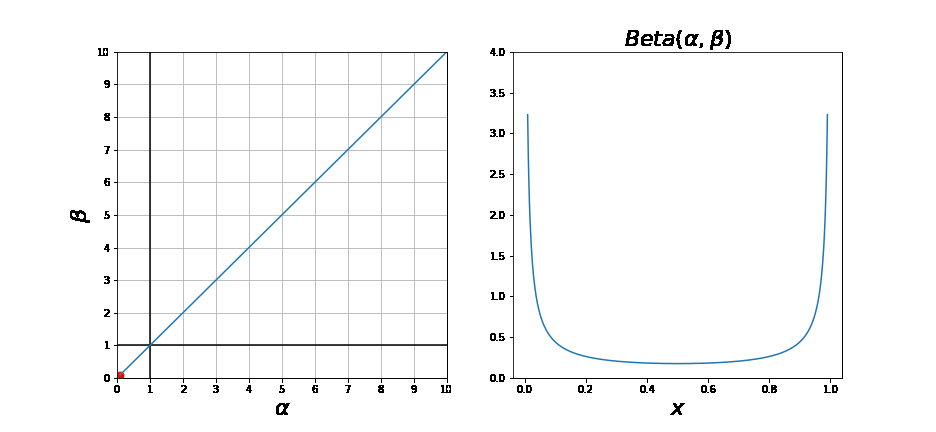

In [5]:
images = []
for i in range(len(t)):
    images.append(imageio.imread(figpath/f'1-{i:02d}.png'))
gif = gifspath/'1.gif'
imageio.mimsave(gif, images)
Image(filename=gif)

In [6]:
t = np.logspace(np.log10(.5), np.log10(9.5))
ones = np.ones_like(t)
tx = np.r_[t, t[-1]*ones, t[::-1], t[0]*ones]
ty = np.r_[t[0]*ones, t, t[-1]*ones, t[::-1]]

fig, axes = plt.subplots(1, 2)
fig.set_size_inches(13, 6)
for i, (tx_, ty_) in enumerate(zip(tx, ty)):
    ax = axes[0]
    abplot(ax, fontdict)
    ax.plot(tx, ty)
    ax.scatter(tx_, ty_, c='r', s=50)
    
    ax = axes[1]
    rv = beta(tx_, ty_)
    ax.plot(x, rv.pdf(x))
    ax.set_xlabel(r'$x$', **fontdict)
    ax.set_title(r'$Beta(\alpha, \beta)$', **fontdict)
    ax.set_ylim(0, 4)
    
    fig.savefig(figpath/f'2-{i:03d}.png')
    axes[0].cla()
    axes[1].cla()
plt.close(fig) 

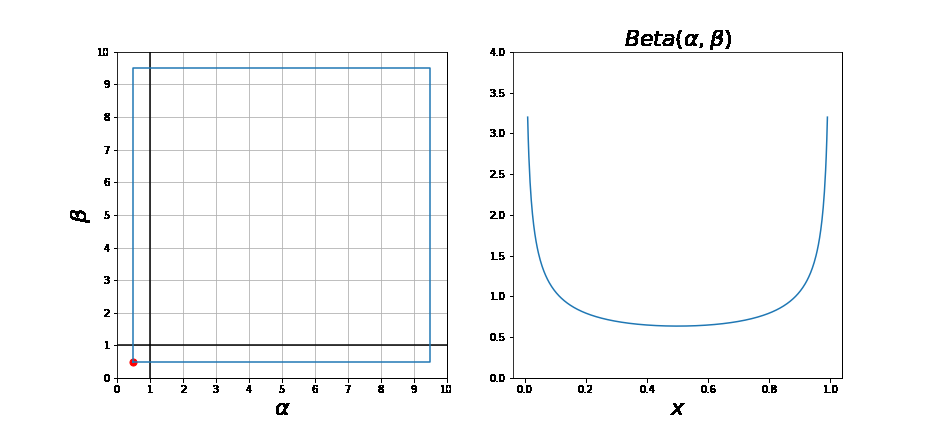

In [7]:
images = []
for i in range(len(tx)):
    images.append(imageio.imread(figpath/f'2-{i:03d}.png'))
gif = gifspath/'2.gif'
imageio.mimsave(gif, images)
Image(filename=gif)